In [3]:
pip install -U scikit-learn

Note: you may need to restart the kernel to use updated packages.


In [4]:
pip install seaborn

Note: you may need to restart the kernel to use updated packages.


In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


In [6]:
df = pd.read_csv('2023-PUDB.csv')

In [7]:
df.head(5).T

,0,1,2,3,4
Year,2023,2023,2023,2023,2023
LoanCharacteristicsID,2749708,2749709,2749710,2749711,2749712
Bank,Boston,Boston,Boston,Boston,Boston
FIPSStateNumericCode,9,9,44,33,25
FIPSCountyCode,3,3,1,5,17
CoreBasedStatisticalAreaCode,25540,25540,39300,28300,14460
CensusTractIdentifier,4901.0,4963.0,309.02,9704.01,3563.0
CensusTractMinorityRatioPercent,30.787,31.863,8.197,8.824,32.652
CensusTractMedFamIncomeAmount,87445,128059,131779,89571,97813
LocalAreaMedianIncomeAmount,106293,106293,94723,91843,123334


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34273 entries, 0 to 34272
Data columns (total 56 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Year                             34273 non-null  int64  
 1   LoanCharacteristicsID            34273 non-null  int64  
 2   Bank                             34273 non-null  object 
 3   FIPSStateNumericCode             34273 non-null  int64  
 4   FIPSCountyCode                   34273 non-null  int64  
 5   CoreBasedStatisticalAreaCode     34273 non-null  int64  
 6   CensusTractIdentifier            34273 non-null  float64
 7   CensusTractMinorityRatioPercent  34273 non-null  float64
 8   CensusTractMedFamIncomeAmount    34273 non-null  int64  
 9   LocalAreaMedianIncomeAmount      34273 non-null  int64  
 10  TotalMonthlyIncomeAmount         34273 non-null  int64  
 11  HUDMedianIncomeAmount            34273 non-null  int64  
 12  LoanAcquisitionAct

In [9]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Year,34273.0,2.023000e+03,0.000000,2023.0,2023.000,2023.000,2023.000,2023.00
LoanCharacteristicsID,34273.0,2.771294e+06,16056.741181,2745322.0,2759157.000,2770100.000,2778870.000,2813827.00
FIPSStateNumericCode,34273.0,3.079558e+01,14.344956,1.0,19.000,27.000,42.000,72.00
FIPSCountyCode,34273.0,9.431722e+01,87.450196,1.0,31.000,79.000,129.000,810.00
CoreBasedStatisticalAreaCode,34273.0,3.834461e+04,26977.738168,10100.0,19740.000,31180.000,41180.000,99999.00
CensusTractIdentifier,34273.0,2.861779e+03,3814.961322,0.0,103.020,417.020,5749.000,9856.00
CensusTractMinorityRatioPercent,34273.0,2.097108e+01,17.082932,0.0,8.993,15.301,26.796,99.84
CensusTractMedFamIncomeAmount,34273.0,9.662512e+04,34693.929393,0.0,73622.000,90000.000,112582.000,250001.00
LocalAreaMedianIncomeAmount,34273.0,8.499761e+04,13048.229243,0.0,76387.000,84250.000,91127.000,157167.00
TotalMonthlyIncomeAmount,34273.0,1.319576e+04,13676.245661,914.0,7200.000,10534.000,15486.000,1027471.00


In [10]:
for col in df.columns:
    print(f"Column '{col}': {df[col].nunique()} unique values")

Column 'Year': 1 unique values
Column 'LoanCharacteristicsID': 34273 unique values
Column 'Bank': 9 unique values
Column 'FIPSStateNumericCode': 52 unique values
Column 'FIPSCountyCode': 221 unique values
Column 'CoreBasedStatisticalAreaCode': 753 unique values
Column 'CensusTractIdentifier': 8746 unique values
Column 'CensusTractMinorityRatioPercent': 13722 unique values
Column 'CensusTractMedFamIncomeAmount': 14149 unique values
Column 'LocalAreaMedianIncomeAmount': 1256 unique values
Column 'TotalMonthlyIncomeAmount': 16845 unique values
Column 'HUDMedianIncomeAmount': 480 unique values
Column 'LoanAcquisitionActualUPBAmt': 9949 unique values
Column 'LTVRatioPercent': 493 unique values
Column 'NoteDate': 11 unique values
Column 'LoanAcquisitionDate': 1 unique values
Column 'LoanPurposeType': 3 unique values
Column 'ProductCategoryName': 1 unique values
Column 'MortgageType': 4 unique values
Column 'ScheduledTotalPaymentCount': 17 unique values
Column 'LoanAmortizationMaxTermMonths':

In [11]:
counts = df['Bank'].value_counts(normalize=True)*100
print(counts)

Bank
Chicago         24.666647
Des Moines      22.948093
Indianapolis    14.851341
Topeka          12.344995
Dallas           9.447670
Cincinnati       5.663350
Pittsburgh       4.116943
Boston           3.807662
New York         2.153299
Name: proportion, dtype: float64


In [12]:
counts = df['MarginRatePercent'].value_counts(normalize=True)*100
print(counts)

MarginRatePercent
9999    85.148659
0       14.851341
Name: proportion, dtype: float64


In [13]:
counts = df['NoteDate'].value_counts(normalize=True)*100
print(counts)

NoteDate
2023    97.190208
2022     2.561783
2021     0.128381
2020     0.078779
2013     0.017506
2016     0.008753
2010     0.002918
2011     0.002918
2015     0.002918
2014     0.002918
2019     0.002918
Name: proportion, dtype: float64


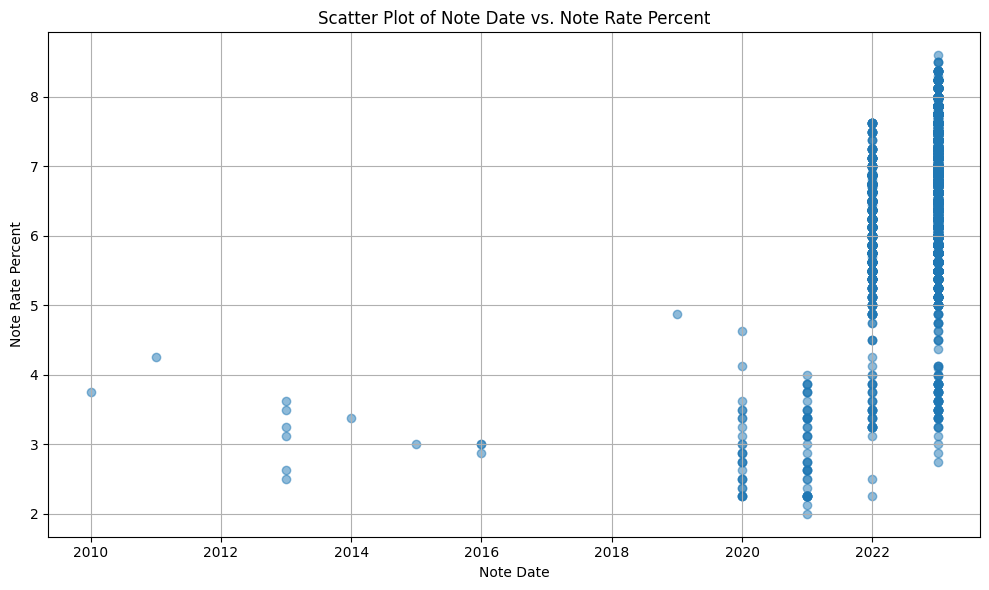

In [14]:
plt.figure(figsize=(10, 6))  # Adjust figure size as needed

# If you want to plot against the actual date:
plt.scatter(df['NoteDate'], df['NoteRatePercent'], alpha=0.5)  # alpha for transparency if points overlap

# If you want to plot against the year (more aggregated):
# plt.scatter(df['Year'], df['NoteRatePercent'], alpha=0.5)

plt.xlabel('Note Date') # Or 'Year' if you plotted by year
plt.ylabel('Note Rate Percent')
plt.title('Scatter Plot of Note Date vs. Note Rate Percent')

# Format x-axis if plotting against the full date

plt.grid(True)
plt.tight_layout() # Adjust layout to prevent labels from overlapping
plt.show()

In [15]:
pd.set_option('display.max_rows',None)
counts = df['Borrower2AgeAtApplicationYears'].value_counts(normalize=True)*100
print(counts)

Borrower2AgeAtApplicationYears
998    41.192776
32      2.188311
30      2.162052
29      2.141628
31      2.135792
33      2.051177
34      2.019082
35      1.887783
28      1.864441
27      1.721472
36      1.709801
37      1.686459
26      1.622268
38      1.558078
39      1.520147
40      1.499723
25      1.397602
41      1.353835
42      1.321740
43      1.132086
45      1.099991
44      1.056225
52      1.032883
24      0.974528
46      0.957022
51      0.942433
48      0.936597
47      0.927844
54      0.922009
49      0.916173
56      0.916173
57      0.898667
50      0.875325
55      0.875325
60      0.837394
53      0.834476
58      0.799463
61      0.784874
63      0.749861
59      0.729437
62      0.697342
23      0.691506
64      0.653576
65      0.580632
66      0.533948
67      0.510606
22      0.425991
68      0.385143
70      0.353048
69      0.353048
71      0.347212
72      0.329706
73      0.262597
74      0.245091
75      0.207160
21      0.192571
76      0.189654


In [16]:
df.agg(['count','size','unique'])

,Year,LoanCharacteristicsID,Bank,FIPSStateNumericCode,FIPSCountyCode,CoreBasedStatisticalAreaCode,CensusTractIdentifier,CensusTractMinorityRatioPercent,CensusTractMedFamIncomeAmount,LocalAreaMedianIncomeAmount,...,Borrower1Race3Type,Borrower1Race4Type,Borrower1Race5Type,Borrower2EthnicityType,Borrower2Race2Type,Borrower2Race3Type,Borrower2Race4Type,Borrower2Race5Type,HOEPALoanStatusType,LienPriorityType
count,34273,34273,34273,34273,34273,34273,34273,34273,34273,34273,...,34273,34273,34273,34273,34273,34273,34273,34273,34273,34273
size,34273,34273,34273,34273,34273,34273,34273,34273,34273,34273,...,34273,34273,34273,34273,34273,34273,34273,34273,34273,34273
unique,[2023],"[2749708, 2749709, 2749710, 2749711, 2749712, ...","[Boston, Chicago, Cincinnati, Dallas, Des Moin...","[9, 44, 33, 25, 50, 23, 51, 12, 48, 17, 45, 39...","[3, 1, 5, 17, 11, 25, 23, 9, 21, 7, 510, 19, 1...","[25540, 39300, 28300, 14460, 15540, 12700, 388...","[4901.0, 4963.0, 309.02, 9704.01, 3563.0, 101....","[30.787, 31.863, 8.197, 8.824, 32.652, 10.196,...","[87445, 128059, 131779, 89571, 97813, 69261, 1...","[106293, 94723, 91843, 123334, 100684, 107577,...",...,"[7, 5, 6]","[7, 6]","[7, 6]","[2, 3, 5, 1, 4]","[7, 8, 5, 3, 2, 6, 1, 4]","[7, 8, 4, 5, 6, 3]","[7, 8, 6, 4]","[7, 8, 6]","[2, 3, 1]",[1]


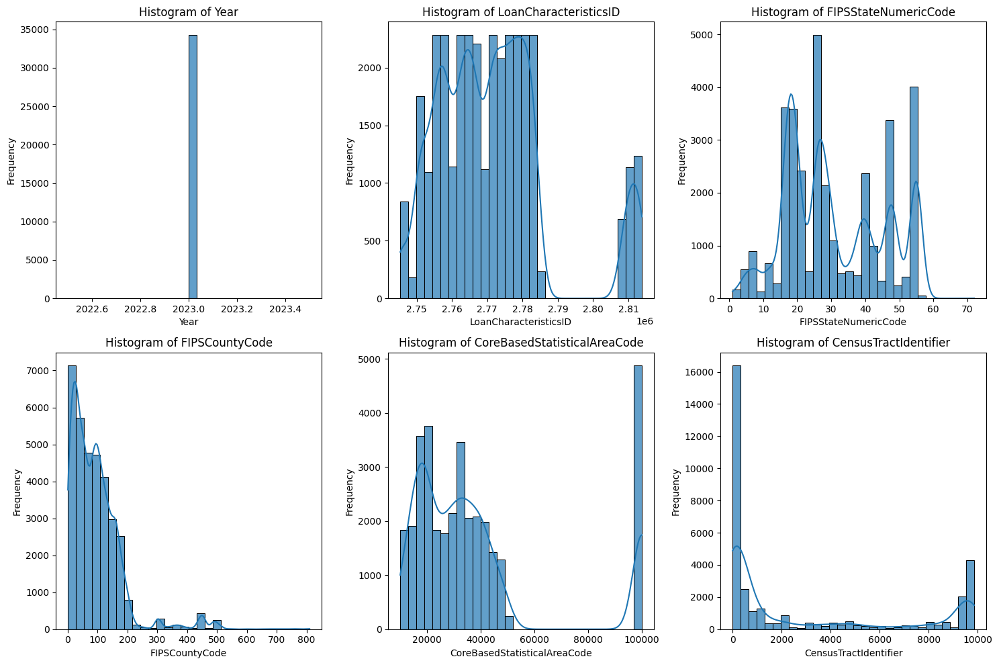

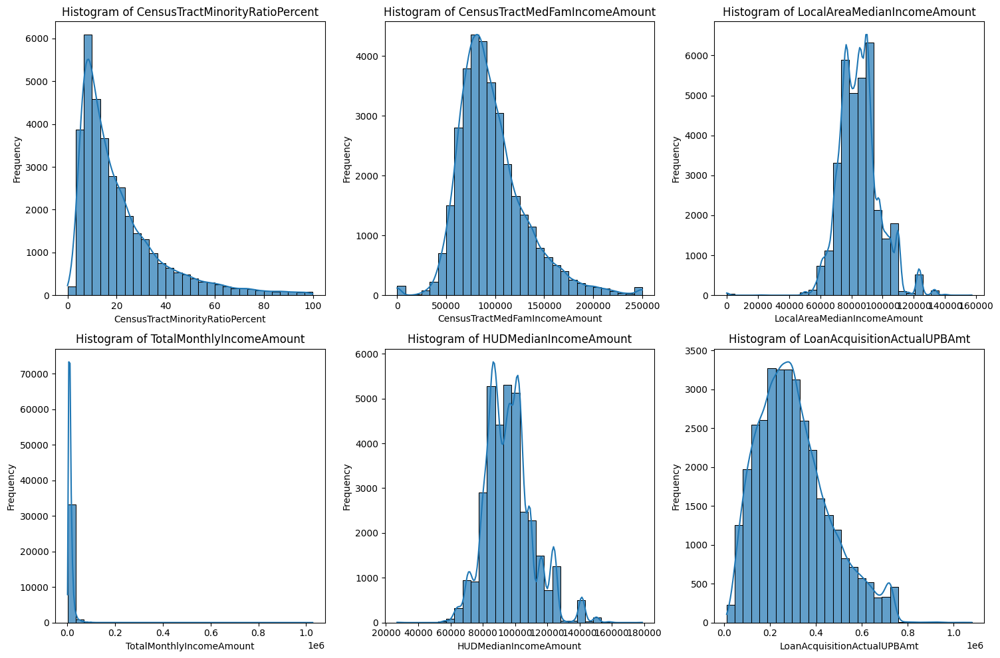

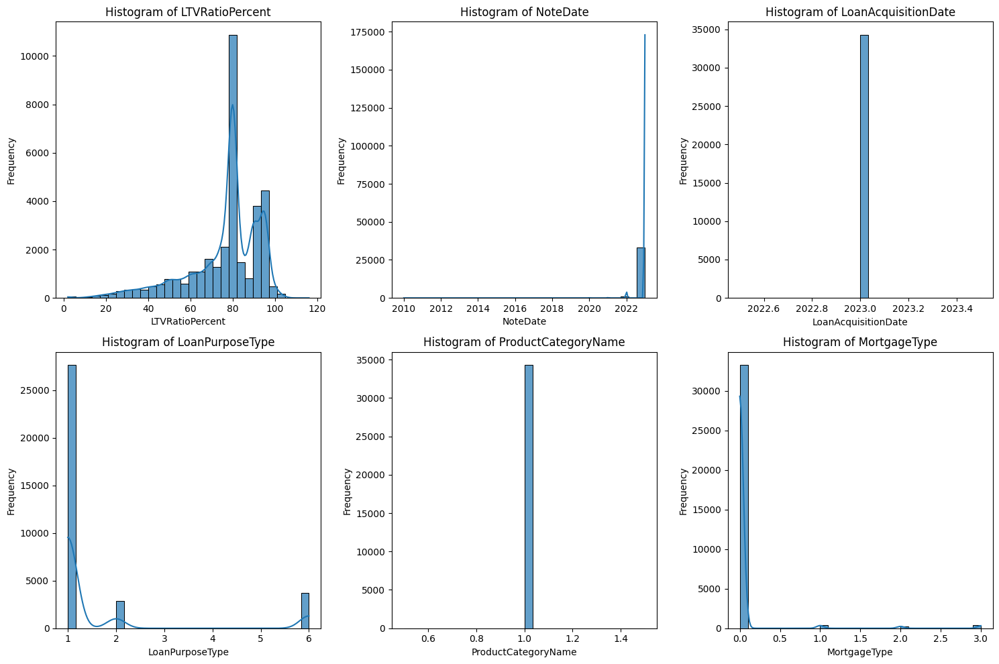

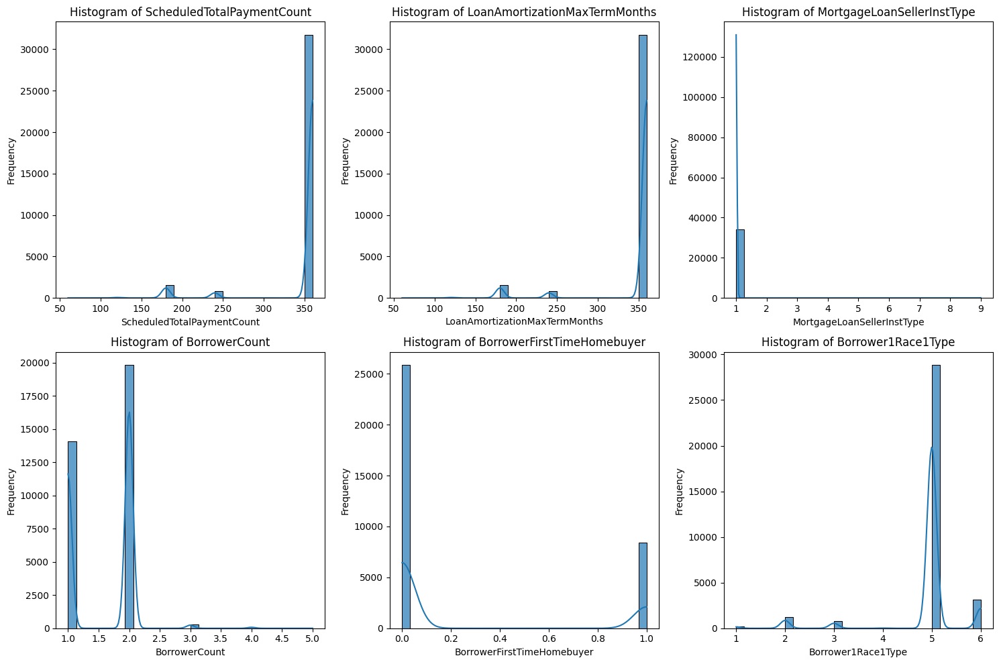

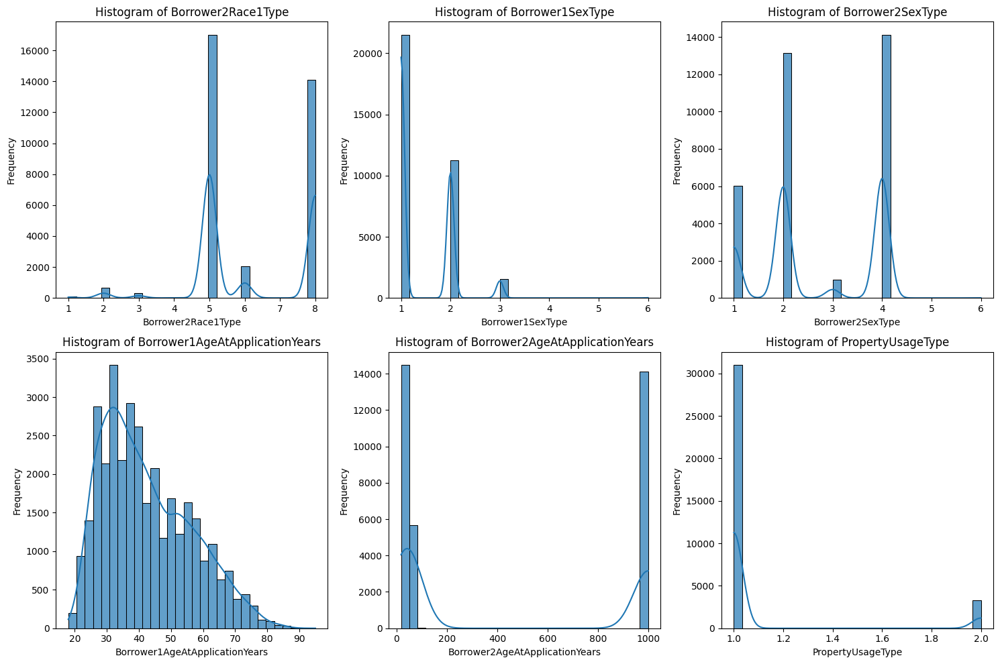

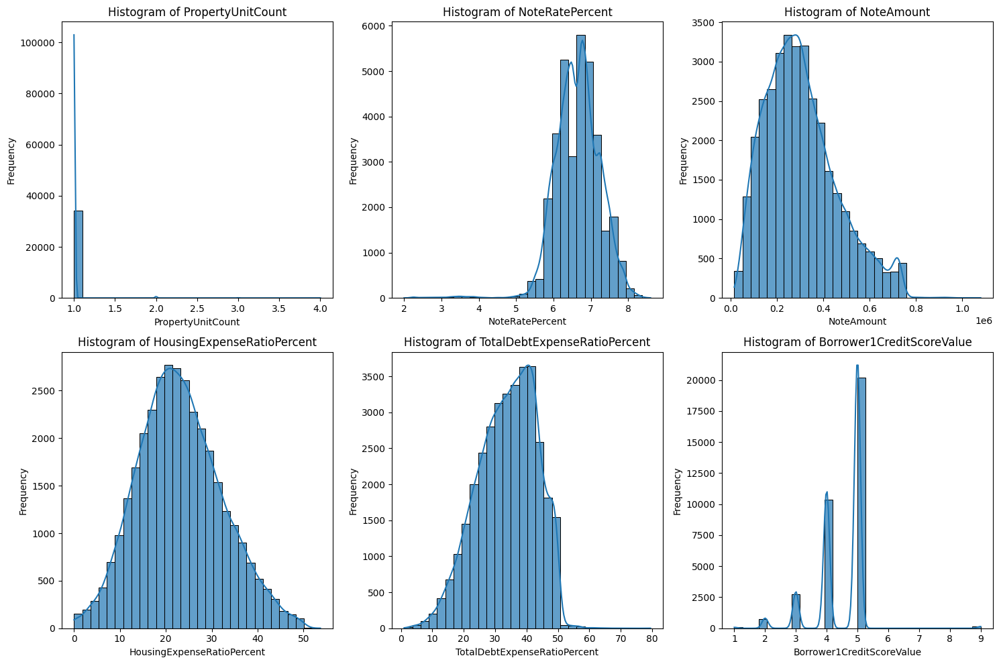

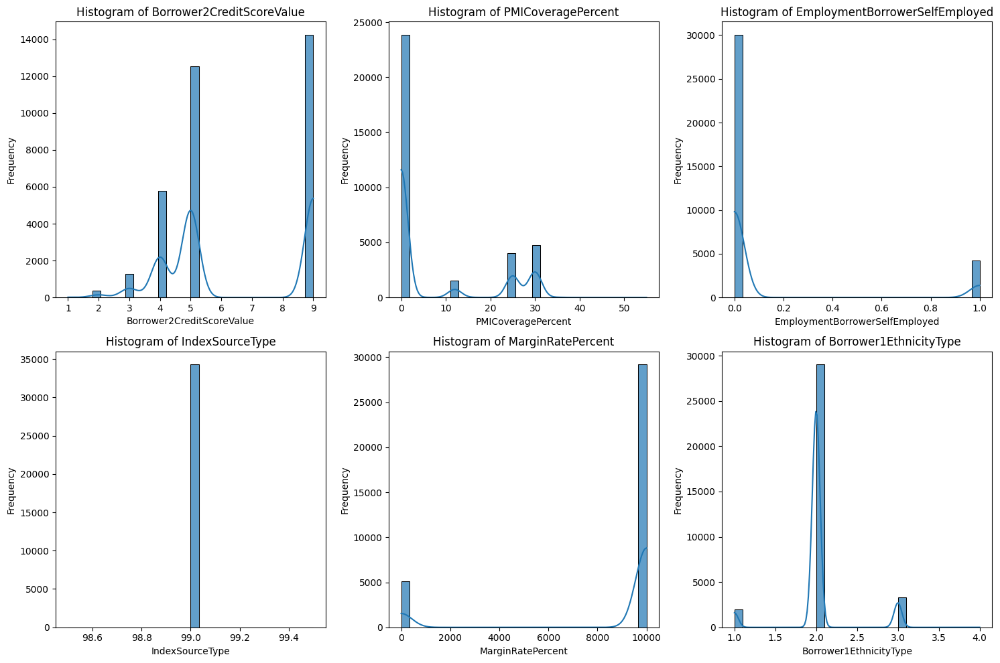

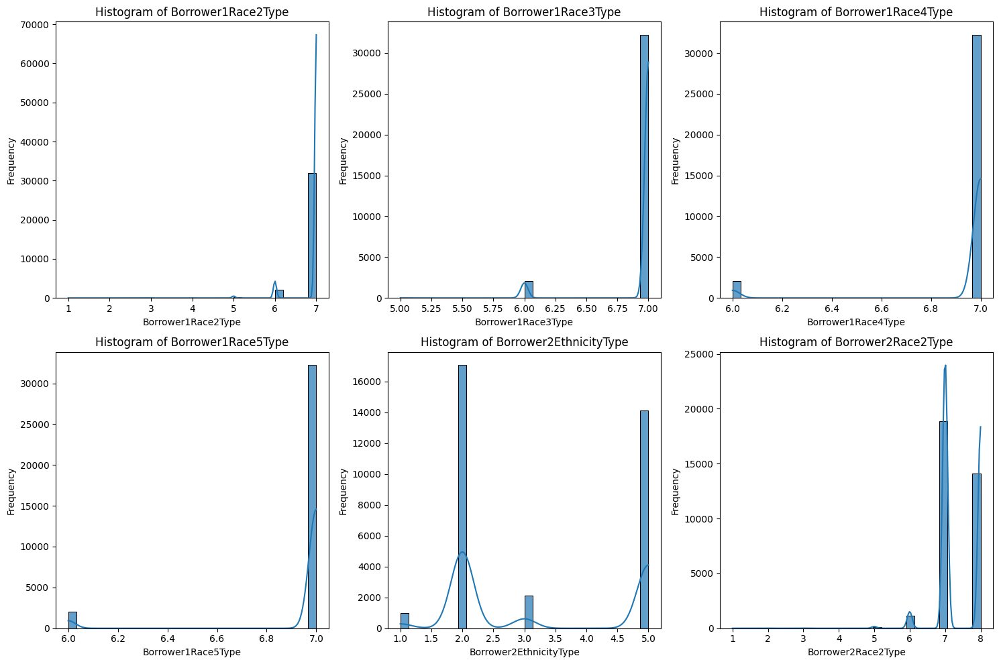

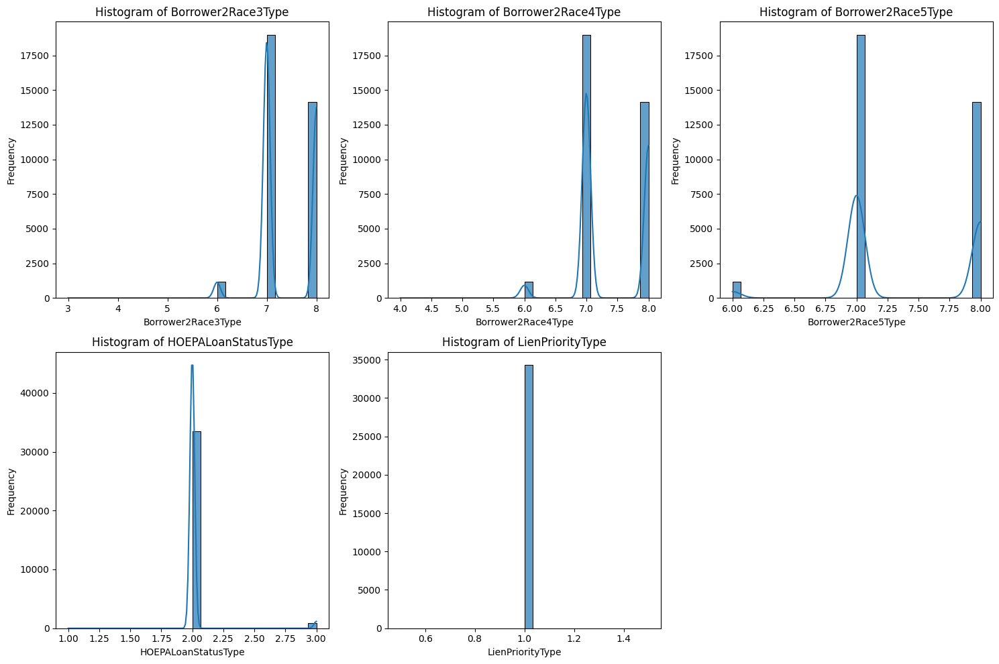

In [17]:
# Select only numeric columns for histogram plotting
numeric_cols = df.select_dtypes(include=[np.number])

# Function to plot histograms in batches
def plot_histograms_in_batches(data, batch_size=6):
    num_batches = (len(data.columns) // batch_size) + 1

    for batch in range(num_batches):
        start_idx = batch * batch_size
        end_idx = min(start_idx + batch_size, len(data.columns))
        cols_to_plot = data.columns[start_idx:end_idx]
        
        if len(cols_to_plot) == 0:
            break

        plt.figure(figsize=(15, 10))
        for i, col in enumerate(cols_to_plot):
            plt.subplot(2, 3, i + 1)
            sns.histplot(data[col].dropna(), bins=30, kde=True,edgecolor='black', alpha=0.7)
            plt.title(f"Histogram of {col}")
            plt.xlabel(col)
            plt.ylabel("Frequency")

        plt.tight_layout()
        plt.show()

# Run the function on the dataset
plot_histograms_in_batches(numeric_cols,batch_size=6)

## histogram description (check skewness)

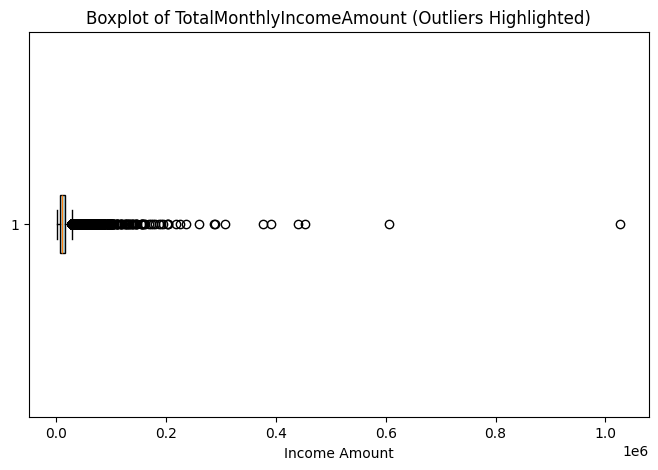

Total Outliers: 216
Outlier Values (First 10): 
410      84471
576     101080
949      86607
1220     77313
1374    105491
1676    225060
2703     99590
2966    156679
3217     72324
3697     76321
Name: TotalMonthlyIncomeAmount, dtype: int64


In [19]:
column_name = "TotalMonthlyIncomeAmount"

if column_name in df.columns:
    data = df[column_name].dropna()
    
    # Calculate Q1, Q3, and IQR
    Q1 = np.percentile(data, 5)
    Q3 = np.percentile(data, 95)
    IQR = Q3 - Q1

    # Define outlier bounds
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Identify outliers
    outliers = data[(data < lower_bound) | (data > upper_bound)]

    # Plot boxplot
    plt.figure(figsize=(8, 5))
    plt.boxplot(data, vert=False, patch_artist=True, boxprops=dict(facecolor="lightblue"))
    plt.title(f"Boxplot of {column_name} (Outliers Highlighted)")
    plt.xlabel("Income Amount")

    # Show the plot
    plt.show()

    # Print outlier statistics
    print(f"Total Outliers: {len(outliers)}")
    print(f"Outlier Values (First 10): \n{outliers.head(10)}")

else:
    print(f"Column '{column_name}' not found in the dataset.")

### Check duplicates

In [21]:
duplicates = df.duplicated().sum()

print(duplicates)



0


### Dropping colums - 'Year','LoanAcquisitionDate','ProductCategoryName','MortgageLoanSellerInstType','IndexSourceType','MarginRatePercent','PrepaymentPenaltyExpirationDate','LienPriorityType'

In [23]:
df.drop(columns=['Year','LoanAcquisitionDate','ProductCategoryName','MortgageLoanSellerInstType','LoanAmortizationMaxTermMonths','Borrower1Race3Type','Borrower1Race4Type','Borrower1Race5Type'
                 ,'Borrower2Race3Type','Borrower2Race4Type','Borrower2Race5Type','IndexSourceType','MarginRatePercent','PrepaymentPenaltyExpirationDate','LienPriorityType','CoreBasedStatisticalAreaCode'], inplace=True)

In [24]:
len(df.columns) ## 56 to 47

40

In [25]:
# since the columns of borrowerrace type remains similar we decided to drop them 

In [26]:
pd.set_option('display.max_rows',None)
counts = df['Borrower2AgeAtApplicationYears'].value_counts(normalize=True)*100
print(counts)

Borrower2AgeAtApplicationYears
998    41.192776
32      2.188311
30      2.162052
29      2.141628
31      2.135792
33      2.051177
34      2.019082
35      1.887783
28      1.864441
27      1.721472
36      1.709801
37      1.686459
26      1.622268
38      1.558078
39      1.520147
40      1.499723
25      1.397602
41      1.353835
42      1.321740
43      1.132086
45      1.099991
44      1.056225
52      1.032883
24      0.974528
46      0.957022
51      0.942433
48      0.936597
47      0.927844
54      0.922009
49      0.916173
56      0.916173
57      0.898667
50      0.875325
55      0.875325
60      0.837394
53      0.834476
58      0.799463
61      0.784874
63      0.749861
59      0.729437
62      0.697342
23      0.691506
64      0.653576
65      0.580632
66      0.533948
67      0.510606
22      0.425991
68      0.385143
70      0.353048
69      0.353048
71      0.347212
72      0.329706
73      0.262597
74      0.245091
75      0.207160
21      0.192571
76      0.189654


In [27]:
less_than_18 = df['Borrower2AgeAtApplicationYears'].lt(18).any() # checking if any co-signer is a minor

print(less_than_18)  # Output: True if any rows has value less than 18

False


In [28]:
#is_18 = df['Borrower2AgeAtApplicationYears'].isin([998]).any()
#print(is_18)

In [29]:
# number of rows with 998 code
df[df['Borrower2AgeAtApplicationYears'] == 998].shape[0]

14118

### Replacing 998 code with 0 as age number for Borrower2AgeAtApplicationYears

In [31]:
df['Borrower2AgeAtApplicationYears'].replace(998, 0, inplace=True)

In [32]:
df[df['Borrower2AgeAtApplicationYears'] == 998].shape[0]

0

In [33]:
pd.set_option('display.max_rows',None)
counts = df['Borrower2AgeAtApplicationYears'].value_counts(normalize=True)*100
print(counts)

Borrower2AgeAtApplicationYears
0     41.192776
32     2.188311
30     2.162052
29     2.141628
31     2.135792
33     2.051177
34     2.019082
35     1.887783
28     1.864441
27     1.721472
36     1.709801
37     1.686459
26     1.622268
38     1.558078
39     1.520147
40     1.499723
25     1.397602
41     1.353835
42     1.321740
43     1.132086
45     1.099991
44     1.056225
52     1.032883
24     0.974528
46     0.957022
51     0.942433
48     0.936597
47     0.927844
54     0.922009
49     0.916173
56     0.916173
57     0.898667
50     0.875325
55     0.875325
60     0.837394
53     0.834476
58     0.799463
61     0.784874
63     0.749861
59     0.729437
62     0.697342
23     0.691506
64     0.653576
65     0.580632
66     0.533948
67     0.510606
22     0.425991
68     0.385143
70     0.353048
69     0.353048
71     0.347212
72     0.329706
73     0.262597
74     0.245091
75     0.207160
21     0.192571
76     0.189654
77     0.142970
20     0.134216
78     0.096286
79     0.

### label encoding 

In [35]:

from sklearn.preprocessing import LabelEncoder

columns = ['Bank','PropertyType']

label_encoders = {}  # Store encoders for potential inverse transforms

for column in columns:
    label_encoders[column] = LabelEncoder()
    df[column] = label_encoders[column].fit_transform(df[column])+1

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34273 entries, 0 to 34272
Data columns (total 40 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   LoanCharacteristicsID            34273 non-null  int64  
 1   Bank                             34273 non-null  int64  
 2   FIPSStateNumericCode             34273 non-null  int64  
 3   FIPSCountyCode                   34273 non-null  int64  
 4   CensusTractIdentifier            34273 non-null  float64
 5   CensusTractMinorityRatioPercent  34273 non-null  float64
 6   CensusTractMedFamIncomeAmount    34273 non-null  int64  
 7   LocalAreaMedianIncomeAmount      34273 non-null  int64  
 8   TotalMonthlyIncomeAmount         34273 non-null  int64  
 9   HUDMedianIncomeAmount            34273 non-null  int64  
 10  LoanAcquisitionActualUPBAmt      34273 non-null  int64  
 11  LTVRatioPercent                  34273 non-null  float64
 12  NoteDate          

## Z-score standardization (Normalizing)
### (Try min max if needed)

In [37]:

pd.set_option('display.max_rows',None)

categorical_columns = ['MortgageType', 'Bank', 'PropertyType', 'Borrower2SexType','Borrower2SexType','LTVRatioPercent']  # Add more categories as needed

for col in categorical_columns:
    counts = df[col].value_counts()
    print(f"Value distribution for {col}:\n{counts}\n")


Value distribution for MortgageType:
MortgageType
0    33261
1      387
3      360
2      265
Name: count, dtype: int64

Value distribution for Bank:
Bank
2    8454
5    7865
6    5090
9    4231
4    3238
3    1941
8    1411
1    1305
7     738
Name: count, dtype: int64

Value distribution for PropertyType:
PropertyType
1     26248
6      5543
5      1861
3       186
4       121
11      115
2        87
10       73
8        26
9        11
7         2
Name: count, dtype: int64

Value distribution for Borrower2SexType:
Borrower2SexType
4    14120
2    13142
1     6005
3      995
6       11
Name: count, dtype: int64

Value distribution for Borrower2SexType:
Borrower2SexType
4    14120
2    13142
1     6005
3      995
6       11
Name: count, dtype: int64

Value distribution for LTVRatioPercent:
LTVRatioPercent
80.00     10030
95.00      4209
90.00      3241
75.00      1422
85.00      1080
70.00       707
79.00       411
60.00       390
77.00       371
78.00       362
74.00       340
50.00  

In [38]:
df['LTVRatioPercent'].unique()

array([ 80.  ,  75.  ,  86.  ,  90.  ,  70.  ,  39.  ,  85.  ,  84.  ,
        79.  ,  95.  ,  23.  ,  60.  ,  76.  ,  87.  ,  42.  ,  88.  ,
        65.  ,  94.  ,  47.  ,  37.  ,  45.  ,  81.  ,  19.  ,  55.  ,
        67.  ,  50.  ,  57.  ,  59.  ,  62.  ,  77.  ,  78.  ,  54.  ,
        69.  ,  64.  ,  48.  ,  20.  ,  46.  ,  66.  ,  68.  ,  71.  ,
        35.  ,  30.  ,  93.  ,  73.  ,  61.  , 103.  ,  82.  ,  89.  ,
        49.  ,  15.  ,  83.  ,  74.  ,  32.  ,  56.  ,  26.  ,  72.  ,
        53.  ,  31.  ,  33.  ,  63.  ,  51.  ,  52.  ,  92.  , 100.  ,
        41.  ,  22.  ,  43.  ,  21.  ,  40.  ,  16.  ,  28.  ,  44.  ,
        36.  ,  58.  ,  38.  ,  91.  ,  27.  ,  34.  ,  17.  ,  29.  ,
        25.  ,  18.  ,  24.  , 101.  ,   2.  ,  99.  ,  96.  ,  11.  ,
        13.  ,  97.  ,  98.  , 102.  ,  12.  , 104.  ,  10.  ,  14.  ,
       116.  ,   9.  , 111.  ,   8.  ,   6.  ,  17.7 ,  75.89,  75.56,
        48.41,  73.37,  72.79,  56.51,  46.97,  58.06,  68.97,  66.67,
      

In [39]:
df['PropertyType'].head()

0    1
1    6
2    3
3    1
4    5
Name: PropertyType, dtype: int64

In [40]:
#remove outliers from borrower count 
#borrower 1 sextype and borrower 2 from 6 to 3

In [41]:
change=['Borrower1SexType', 'Borrower2SexType']
for col in change:
    df[col]= df[col].replace(6, 3)

In [42]:
df['Borrower1CreditScoreValue']=df['Borrower1CreditScoreValue'].replace(9,0)

In [43]:
df['Borrower1CreditScoreValue'].unique()

array([4, 5, 2, 3, 0, 1])

In [44]:
df['PropertyType'].unique()

array([ 1,  6,  3,  5,  9,  8, 11,  4,  2,  7, 10])

In [45]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34273 entries, 0 to 34272
Data columns (total 40 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   LoanCharacteristicsID            34273 non-null  int64  
 1   Bank                             34273 non-null  int64  
 2   FIPSStateNumericCode             34273 non-null  int64  
 3   FIPSCountyCode                   34273 non-null  int64  
 4   CensusTractIdentifier            34273 non-null  float64
 5   CensusTractMinorityRatioPercent  34273 non-null  float64
 6   CensusTractMedFamIncomeAmount    34273 non-null  int64  
 7   LocalAreaMedianIncomeAmount      34273 non-null  int64  
 8   TotalMonthlyIncomeAmount         34273 non-null  int64  
 9   HUDMedianIncomeAmount            34273 non-null  int64  
 10  LoanAcquisitionActualUPBAmt      34273 non-null  int64  
 11  LTVRatioPercent                  34273 non-null  float64
 12  NoteDate          

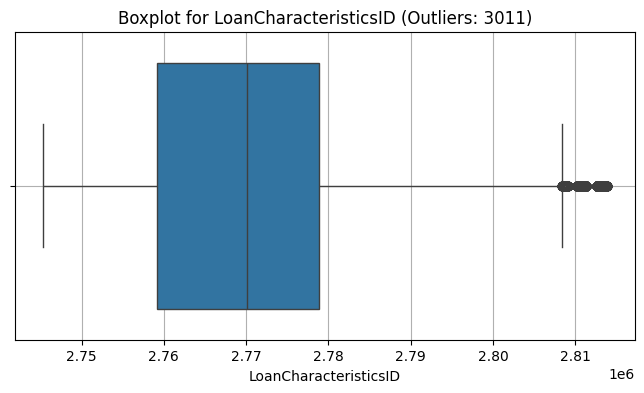

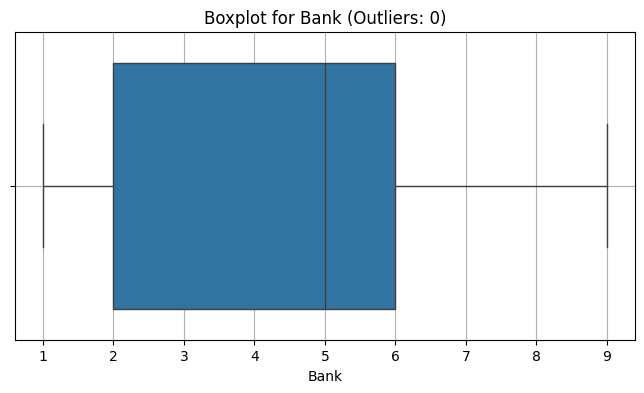

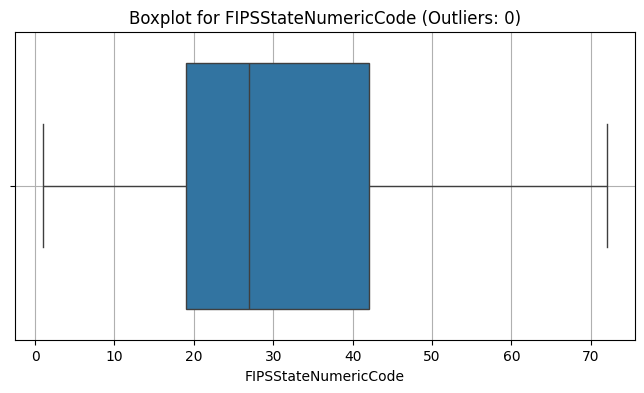

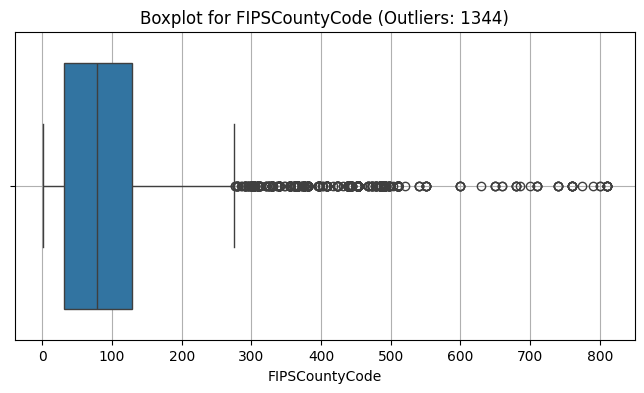

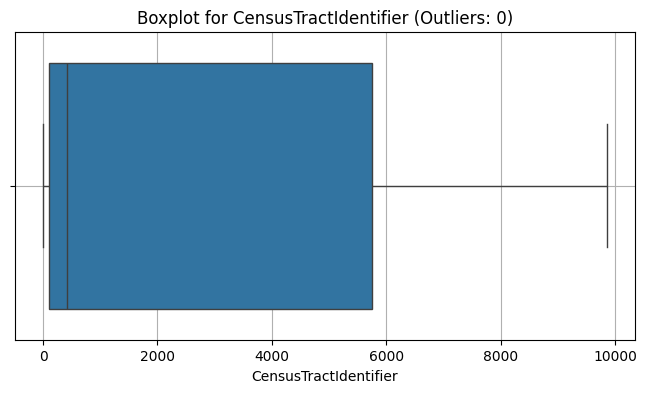

...

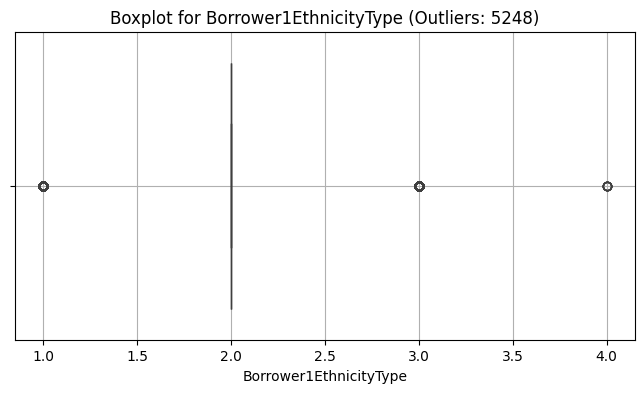

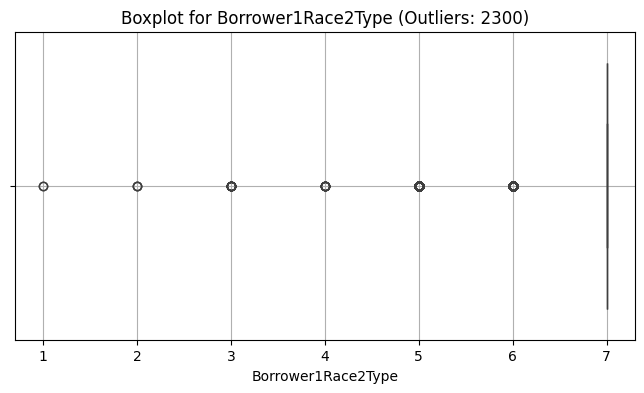

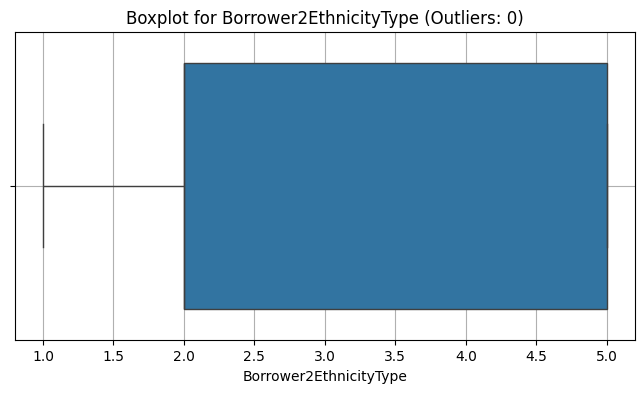

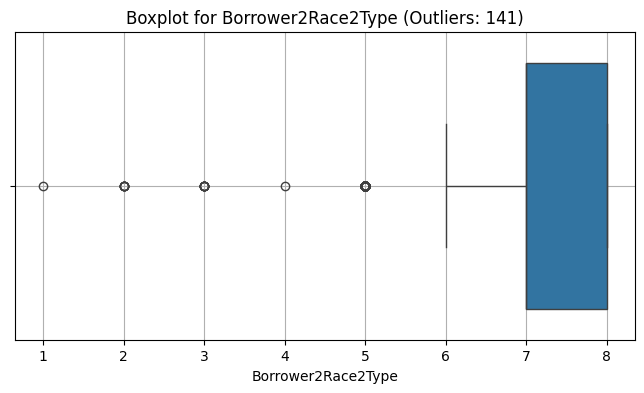

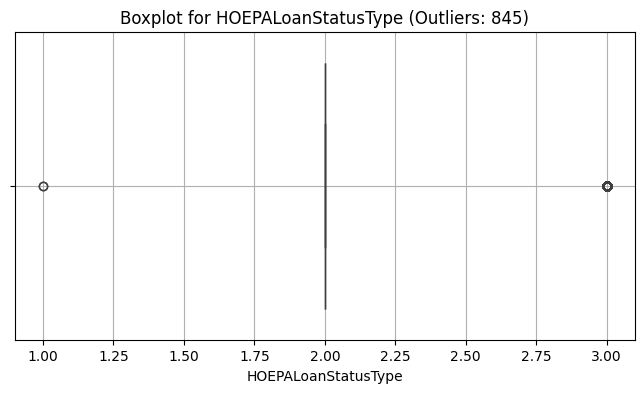

In [46]:

# Select only numerical columns
numerical_columns = df.select_dtypes(include=[np.number]).columns

# Function to count outliers using the IQR method
def count_outliers_iqr(data, column):
    Q1 = data[column].quantile(0.25)
    Q3 = data[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return ((data[column] < lower_bound) | (data[column] > upper_bound)).sum()

# Generate boxplots with outlier counts
for col in numerical_columns:
    outlier_count = count_outliers_iqr(df, col)
    
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=df[col], orient="h")
    plt.title(f'Boxplot for {col} (Outliers: {outlier_count})')
    plt.xlabel(col)
    plt.grid(True)
    plt.show()


Irrelevant Features (Highly Correlated) Recommended for Removal:
{'BorrowerCount', 'LoanAcquisitionActualUPBAmt', 'Borrower2SexType', 'LocalAreaMedianIncomeAmount', 'Borrower2CreditScoreValue', 'Borrower2Race1Type'}


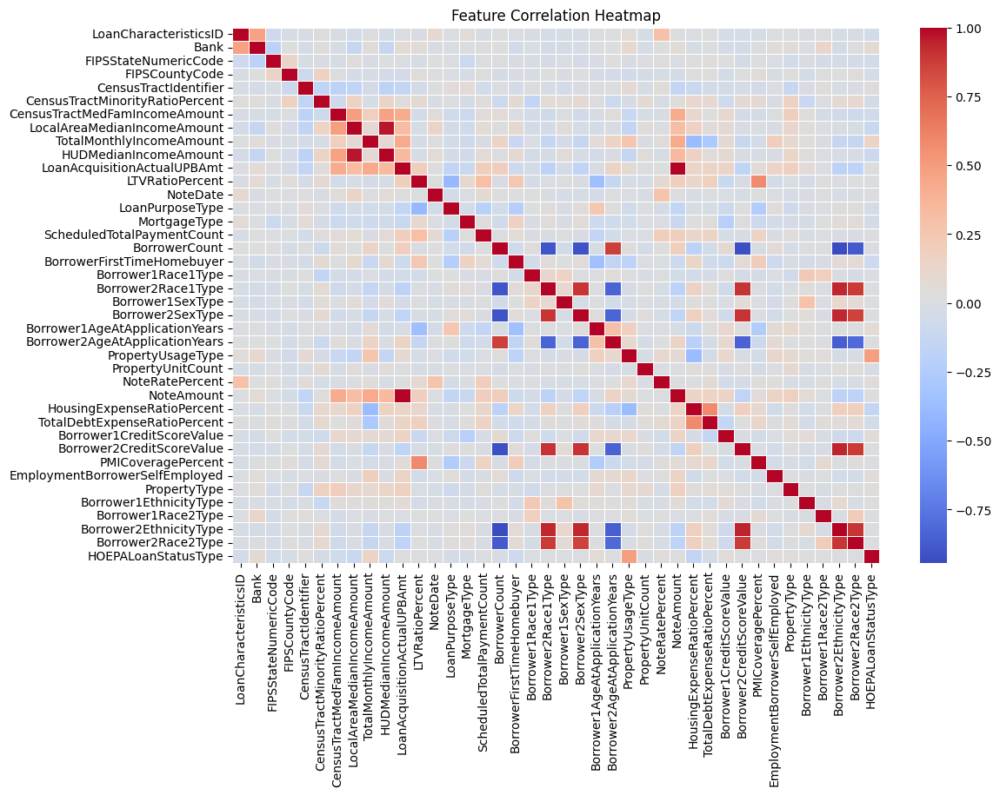

In [47]:
# Select only numerical columns
numerical_df = df.select_dtypes(include=[np.number])

# Compute the correlation matrix
correlation_matrix = numerical_df.corr()

# Identify highly correlated features (correlation coefficient > 0.9)
threshold = 0.9
high_corr_pairs = set()
irrelevant_features = set()

for i in range(len(correlation_matrix.columns)):
    for j in range(i):
        if abs(correlation_matrix.iloc[i, j]) > threshold:
            feature1 = correlation_matrix.columns[i]
            feature2 = correlation_matrix.columns[j]
            high_corr_pairs.add((feature1, feature2))
            irrelevant_features.add(feature2)  # Mark one as redundant

# Print irrelevant features
print("Irrelevant Features (Highly Correlated) Recommended for Removal:")
print(irrelevant_features)

# Plot heatmap of correlation matrix
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=False, cmap="coolwarm", linewidths=0.5)
plt.title("Feature Correlation Heatmap")
plt.show()

In [48]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
# Fit and transform all numeric columns
df_standardized= pd.DataFrame(scaler.fit_transform(df), columns=df.columns)


In [49]:
df_standardized.head().T

,0,1,2,3,4
LoanCharacteristicsID,-1.344352,-1.344290,-1.344227,-1.344165,-1.344103
Bank,-1.560896,-1.560896,-1.560896,-1.560896,-1.560896
FIPSStateNumericCode,-1.519412,-1.519412,0.920505,0.153674,-0.404021
FIPSCountyCode,-1.044235,-1.044235,-1.067105,-1.021364,-0.884141
CensusTractIdentifier,0.534540,0.550792,-0.669154,1.793552,0.183811
CensusTractMinorityRatioPercent,0.574613,0.637600,-0.747779,-0.711075,0.683787
CensusTractMedFamIncomeAmount,-0.264607,0.906047,1.013272,-0.203327,0.034239
LocalAreaMedianIncomeAmount,1.632076,1.632076,0.745353,0.524630,2.938096
TotalMonthlyIncomeAmount,-0.157484,1.411464,-0.380501,-0.679711,-0.175764
HUDMedianIncomeAmount,1.527928,1.527928,0.821242,1.079454,3.063612


In [50]:
df_standardized.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34273 entries, 0 to 34272
Data columns (total 40 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   LoanCharacteristicsID            34273 non-null  float64
 1   Bank                             34273 non-null  float64
 2   FIPSStateNumericCode             34273 non-null  float64
 3   FIPSCountyCode                   34273 non-null  float64
 4   CensusTractIdentifier            34273 non-null  float64
 5   CensusTractMinorityRatioPercent  34273 non-null  float64
 6   CensusTractMedFamIncomeAmount    34273 non-null  float64
 7   LocalAreaMedianIncomeAmount      34273 non-null  float64
 8   TotalMonthlyIncomeAmount         34273 non-null  float64
 9   HUDMedianIncomeAmount            34273 non-null  float64
 10  LoanAcquisitionActualUPBAmt      34273 non-null  float64
 11  LTVRatioPercent                  34273 non-null  float64
 12  NoteDate          

In [51]:
pip install statsmodels

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.9/9.9 MB 17.9 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 232.9/232.9 kB 17.8 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


In [52]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

df_numeric = df_standardized.copy()

# Drop columns with constant values (as VIF cannot be computed for them)
df_numeric = df_numeric.loc[:, df_numeric.nunique() > 1]

# Compute VIF
vif_data = pd.DataFrame()
vif_data["Feature"] = df_numeric.columns
vif_data["VIF"] = [variance_inflation_factor(df_numeric.values, i) for i in range(df_numeric.shape[1])]

# Display VIF scores
print(vif_data.sort_values(by="VIF", ascending=False))

                            Feature         VIF
27                       NoteAmount  694.085720
10      LoanAcquisitionActualUPBAmt  693.224209
37           Borrower2EthnicityType   26.528484
7       LocalAreaMedianIncomeAmount   18.232647
9             HUDMedianIncomeAmount   17.596435
31        Borrower2CreditScoreValue   12.412274
16                    BorrowerCount   12.190416
19               Borrower2Race1Type   11.316747
21                 Borrower2SexType   10.560506
38               Borrower2Race2Type    8.114593
23   Borrower2AgeAtApplicationYears    8.008086
28       HousingExpenseRatioPercent    2.351308
11                  LTVRatioPercent    2.122122
22   Borrower1AgeAtApplicationYears    2.073107
29     TotalDebtExpenseRatioPercent    1.907956
24                PropertyUsageType    1.814448
8          TotalMonthlyIncomeAmount    1.696093
6     CensusTractMedFamIncomeAmount    1.653676
32               PMICoveragePercent    1.641284
0             LoanCharacteristicsID    1

In [53]:
# for regression we will consider only note amount as we are predicting noterateinterest which is more preferred for predicting
#🚨 Real Talk: If you’re doing performance or risk analysis, UPB (*LoanAcquisitionActualUPBAmt*) is usually the better choice.
#Why? Because the risk (or remaining exposure) is based on how much is still outstanding, not what was originally borrowed.

In [54]:
#w eare dropping Borrower2EthnicityType as it has high multicollinearity with borrower2creditscorevalue, borrower2race1type

In [55]:
df_numeric.drop(columns=['LoanAcquisitionActualUPBAmt','Borrower2EthnicityType'], errors='ignore', inplace=True)

In [56]:
df_numeric.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34273 entries, 0 to 34272
Data columns (total 38 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   LoanCharacteristicsID            34273 non-null  float64
 1   Bank                             34273 non-null  float64
 2   FIPSStateNumericCode             34273 non-null  float64
 3   FIPSCountyCode                   34273 non-null  float64
 4   CensusTractIdentifier            34273 non-null  float64
 5   CensusTractMinorityRatioPercent  34273 non-null  float64
 6   CensusTractMedFamIncomeAmount    34273 non-null  float64
 7   LocalAreaMedianIncomeAmount      34273 non-null  float64
 8   TotalMonthlyIncomeAmount         34273 non-null  float64
 9   HUDMedianIncomeAmount            34273 non-null  float64
 10  LTVRatioPercent                  34273 non-null  float64
 11  NoteDate                         34273 non-null  float64
 12  LoanPurposeType   

In [57]:
df_numeric = df_numeric.loc[:, df_numeric.nunique() > 1]

# Compute VIF
vif_data = pd.DataFrame()
vif_data["Feature"] = df_numeric.columns
vif_data["VIF"] = [variance_inflation_factor(df_numeric.values, i) for i in range(df_numeric.shape[1])]

# Display VIF scores
print(vif_data.sort_values(by="VIF", ascending=False))

                            Feature        VIF
7       LocalAreaMedianIncomeAmount  18.173252
9             HUDMedianIncomeAmount  17.547705
15                    BorrowerCount  11.261727
30        Borrower2CreditScoreValue  10.939754
18               Borrower2Race1Type  10.186488
20                 Borrower2SexType   9.087977
36               Borrower2Race2Type   8.016001
22   Borrower2AgeAtApplicationYears   7.784520
27       HousingExpenseRatioPercent   2.351022
10                  LTVRatioPercent   2.121700
21   Borrower1AgeAtApplicationYears   2.060505
26                       NoteAmount   2.017570
28     TotalDebtExpenseRatioPercent   1.903063
23                PropertyUsageType   1.813759
8          TotalMonthlyIncomeAmount   1.694647
6     CensusTractMedFamIncomeAmount   1.653149
31               PMICoveragePercent   1.641189
0             LoanCharacteristicsID   1.493267
1                              Bank   1.463153
35               Borrower1Race2Type   1.443272
17           

In [58]:
#we can create a correlation matrix to figure out which among localareamedianincomeamount and HUD is influential in predicting target var

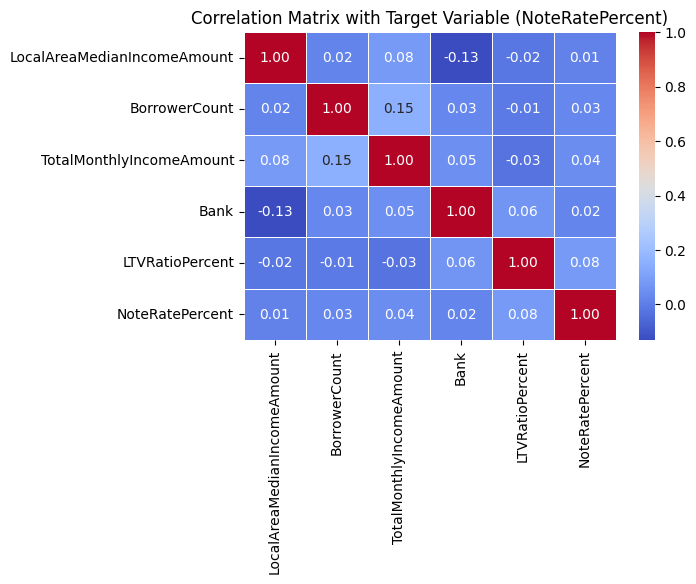

In [59]:

# Selecting relevant columns
selected_columns = ['LocalAreaMedianIncomeAmount','BorrowerCount','TotalMonthlyIncomeAmount', 'Bank','LTVRatioPercent','NoteRatePercent']

# Compute correlation matrix
corr_matrix = df_numeric[selected_columns].corr()

# Plot correlation heatmap
plt.figure(figsize=(6, 4))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title("Correlation Matrix with Target Variable (NoteRatePercent)")
plt.show()


In [60]:
#based on above matrix we will drop HUD

In [61]:
df_numeric.drop(columns=['HUDMedianIncomeAmount'], errors='ignore', inplace=True)

In [62]:
df_numeric = df_numeric.loc[:, df_numeric.nunique() > 1]

# Compute VIF
vif_data = pd.DataFrame()
vif_data["Feature"] = df_numeric.columns
vif_data["VIF"] = [variance_inflation_factor(df_numeric.values, i) for i in range(df_numeric.shape[1])]

# Display VIF scores
print(vif_data.sort_values(by="VIF", ascending=False))

                            Feature        VIF
14                    BorrowerCount  11.261274
29        Borrower2CreditScoreValue  10.939523
17               Borrower2Race1Type  10.186357
19                 Borrower2SexType   9.086692
35               Borrower2Race2Type   8.015736
21   Borrower2AgeAtApplicationYears   7.784395
26       HousingExpenseRatioPercent   2.350564
9                   LTVRatioPercent   2.119217
20   Borrower1AgeAtApplicationYears   2.060390
25                       NoteAmount   1.994812
27     TotalDebtExpenseRatioPercent   1.902998
22                PropertyUsageType   1.813386
8          TotalMonthlyIncomeAmount   1.694614
30               PMICoveragePercent   1.641188
6     CensusTractMedFamIncomeAmount   1.640258
7       LocalAreaMedianIncomeAmount   1.537674
0             LoanCharacteristicsID   1.488593
1                              Bank   1.459090
34               Borrower1Race2Type   1.442336
16               Borrower1Race1Type   1.379492
36           

In [63]:
df_numeric.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34273 entries, 0 to 34272
Data columns (total 37 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   LoanCharacteristicsID            34273 non-null  float64
 1   Bank                             34273 non-null  float64
 2   FIPSStateNumericCode             34273 non-null  float64
 3   FIPSCountyCode                   34273 non-null  float64
 4   CensusTractIdentifier            34273 non-null  float64
 5   CensusTractMinorityRatioPercent  34273 non-null  float64
 6   CensusTractMedFamIncomeAmount    34273 non-null  float64
 7   LocalAreaMedianIncomeAmount      34273 non-null  float64
 8   TotalMonthlyIncomeAmount         34273 non-null  float64
 9   LTVRatioPercent                  34273 non-null  float64
 10  NoteDate                         34273 non-null  float64
 11  LoanPurposeType                  34273 non-null  float64
 12  MortgageType      

### Visualisation


/var/folders/mz/nphybv793yj6yh7yhpm27lv00000gn/T/ipykernel_85996/108675437.py:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=col, data=df, palette='Set2')


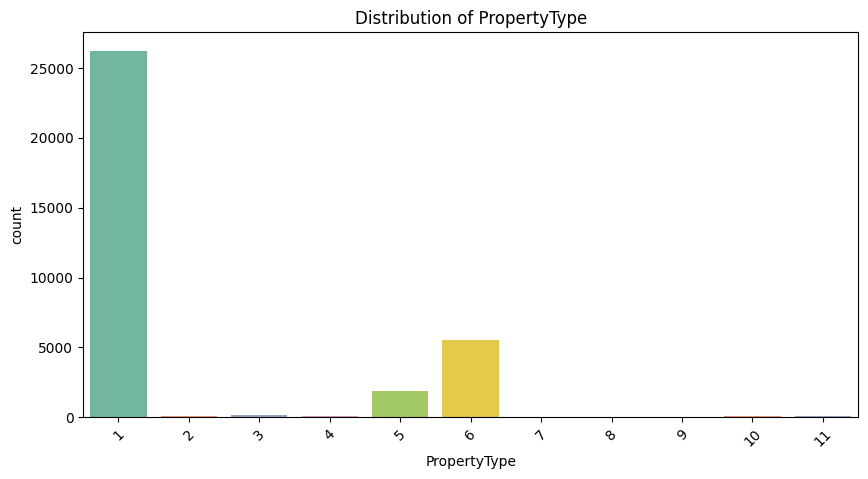

/var/folders/mz/nphybv793yj6yh7yhpm27lv00000gn/T/ipykernel_85996/108675437.py:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=col, data=df, palette='Set2')


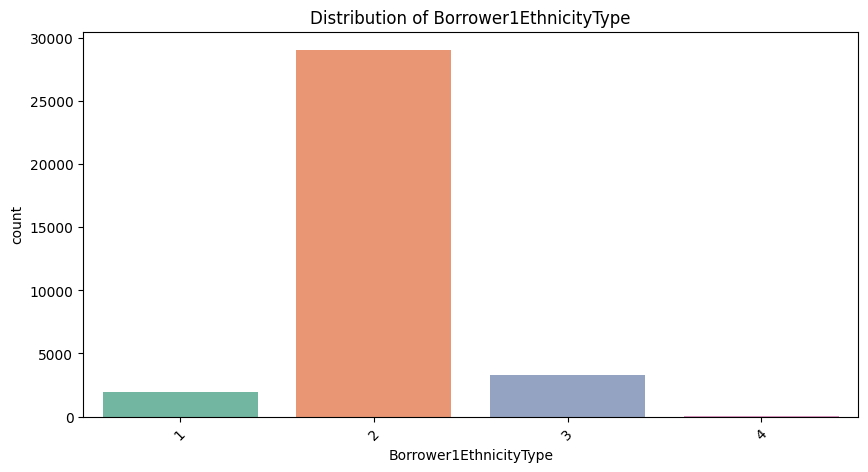

/var/folders/mz/nphybv793yj6yh7yhpm27lv00000gn/T/ipykernel_85996/108675437.py:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=col, data=df, palette='Set2')


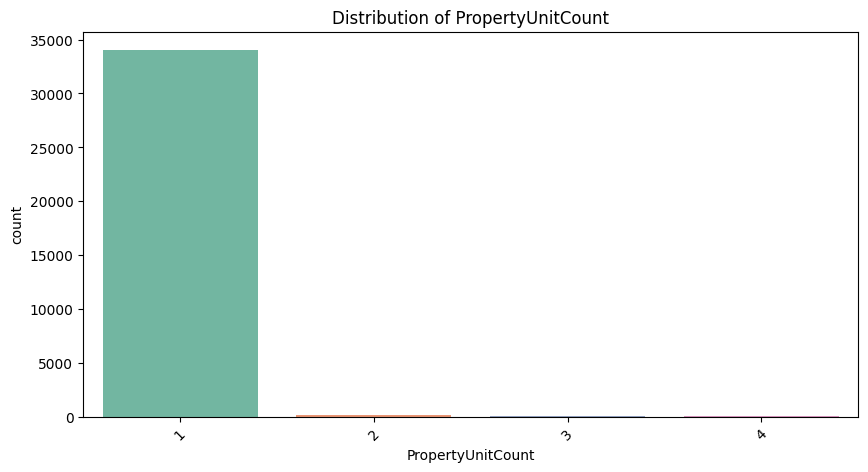

/var/folders/mz/nphybv793yj6yh7yhpm27lv00000gn/T/ipykernel_85996/108675437.py:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=col, data=df, palette='Set2')


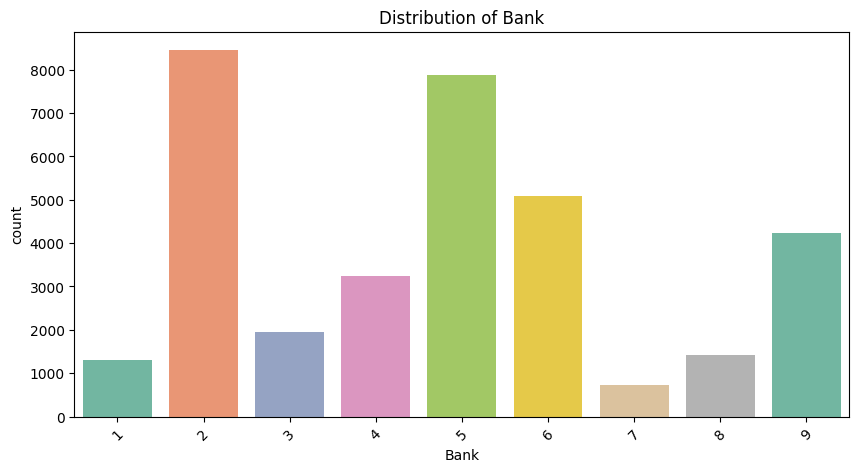

/var/folders/mz/nphybv793yj6yh7yhpm27lv00000gn/T/ipykernel_85996/108675437.py:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=col, data=df, palette='Set2')


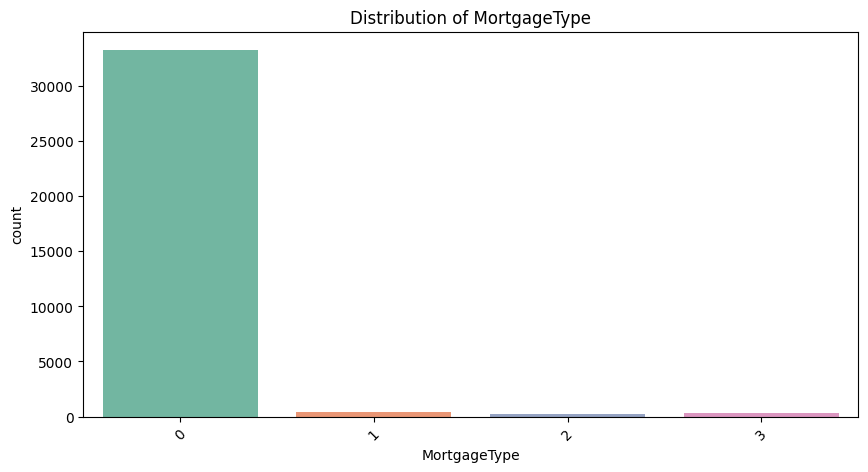

/var/folders/mz/nphybv793yj6yh7yhpm27lv00000gn/T/ipykernel_85996/108675437.py:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=col, data=df, palette='Set2')


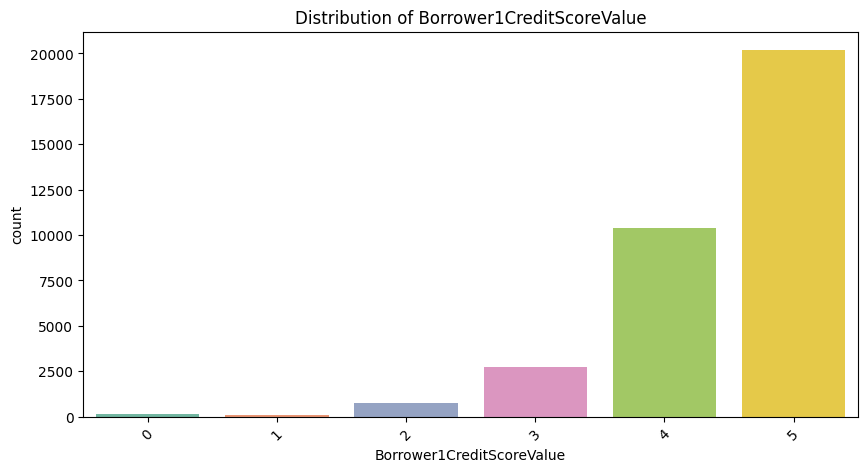

/var/folders/mz/nphybv793yj6yh7yhpm27lv00000gn/T/ipykernel_85996/108675437.py:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=col, data=df, palette='Set2')


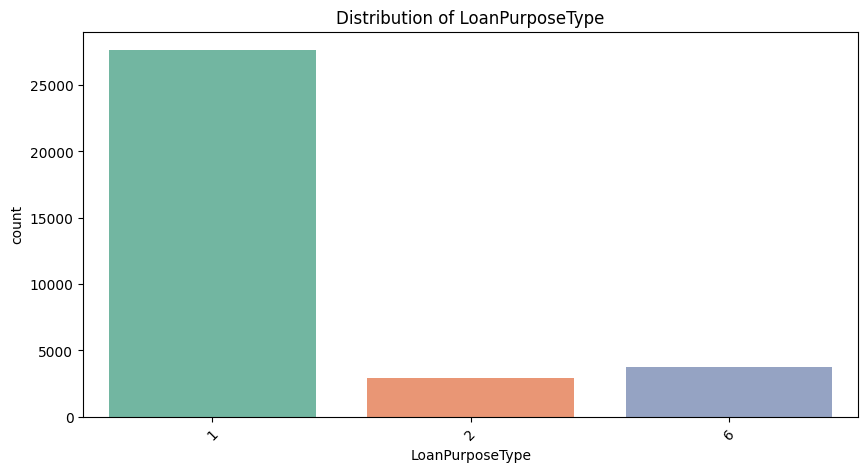

/var/folders/mz/nphybv793yj6yh7yhpm27lv00000gn/T/ipykernel_85996/108675437.py:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=col, data=df, palette='Set2')


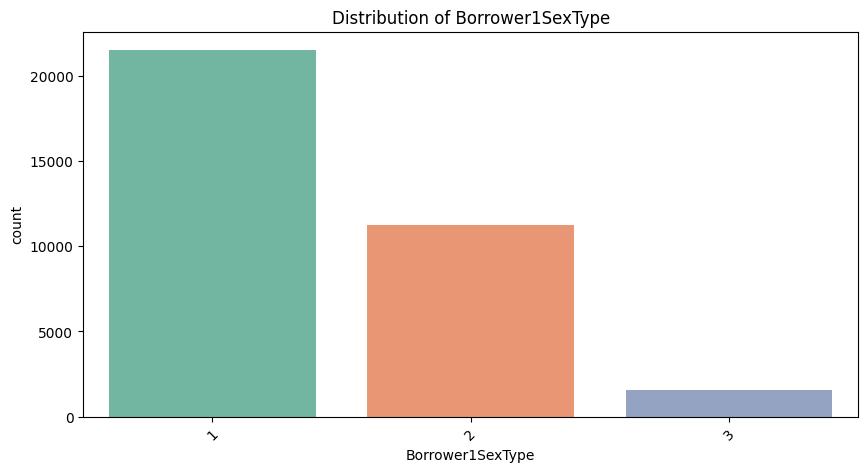

/var/folders/mz/nphybv793yj6yh7yhpm27lv00000gn/T/ipykernel_85996/108675437.py:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=col, data=df, palette='Set2')


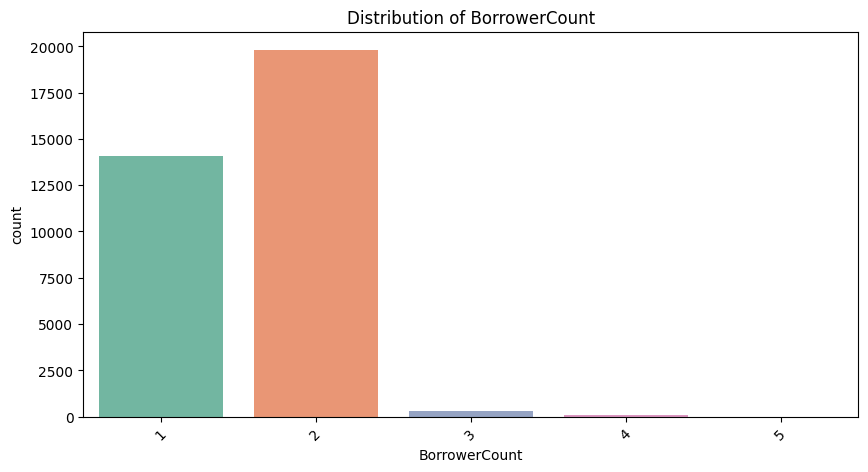

In [65]:
categorical_cols = [
    'PropertyType', 'Borrower1EthnicityType',
    'PropertyUnitCount', 
    'Bank', 'MortgageType', 'Borrower1CreditScoreValue', 
    'LoanPurposeType', 'Borrower1SexType',
    'BorrowerCount'
]

# Loop through each categorical column
for col in categorical_cols:
    plt.figure(figsize=(10, 5))
    sns.countplot(x=col, data=df, palette='Set2')
    plt.title(f'Distribution of {col}')
    plt.xticks(rotation=45)  # Rotating x-axis labels for better readability
    plt.show()


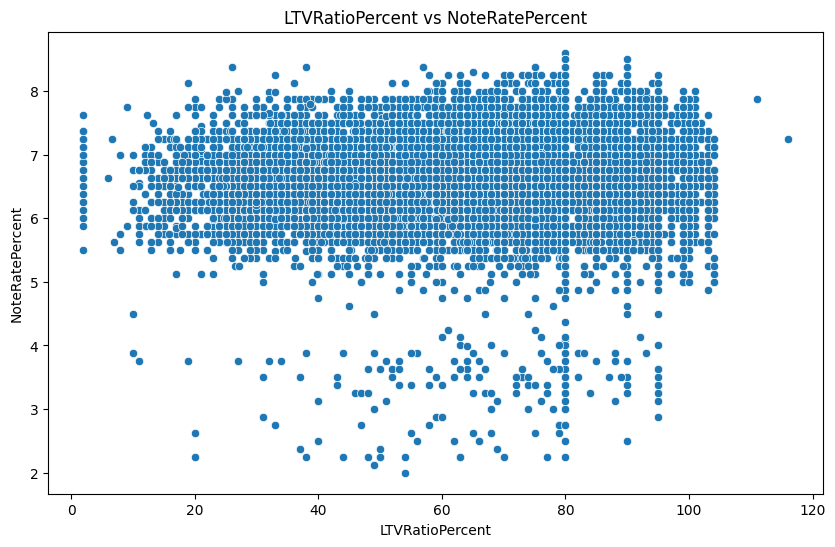

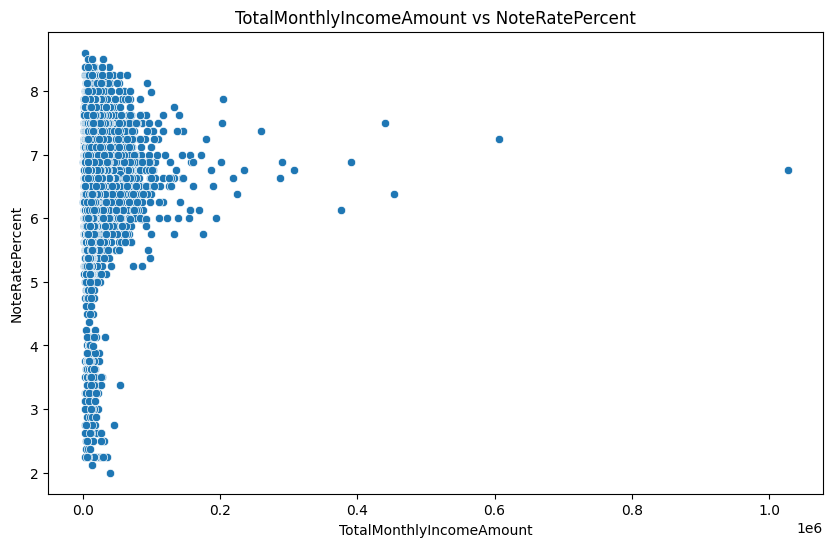

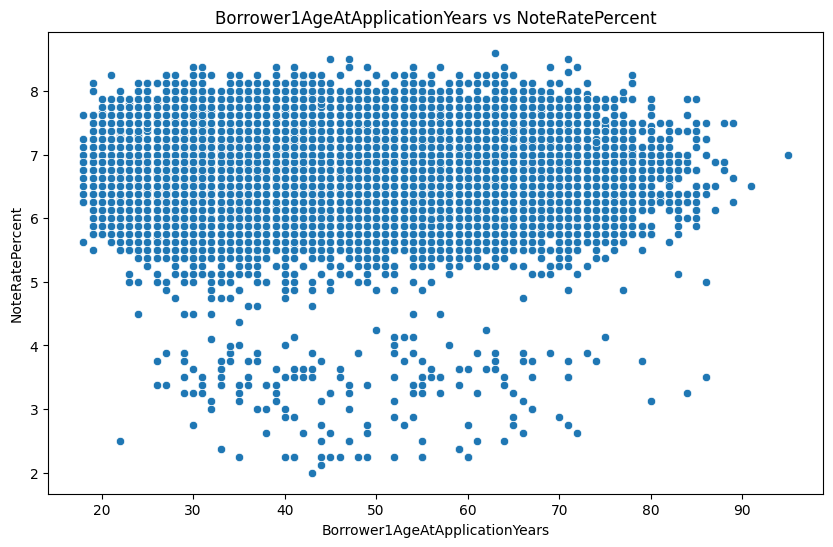

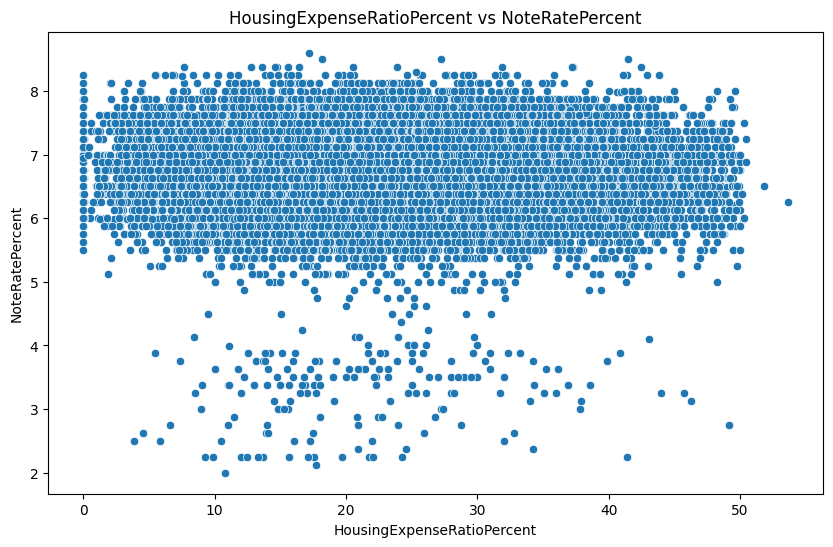

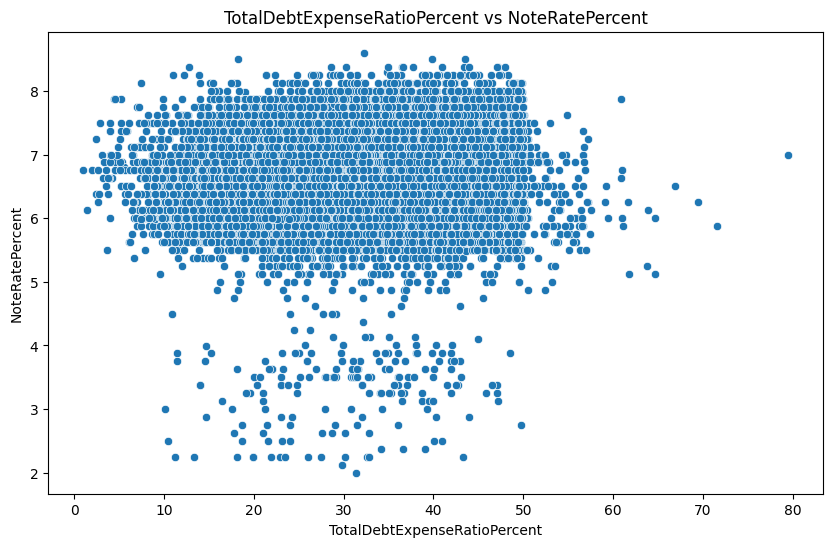

...

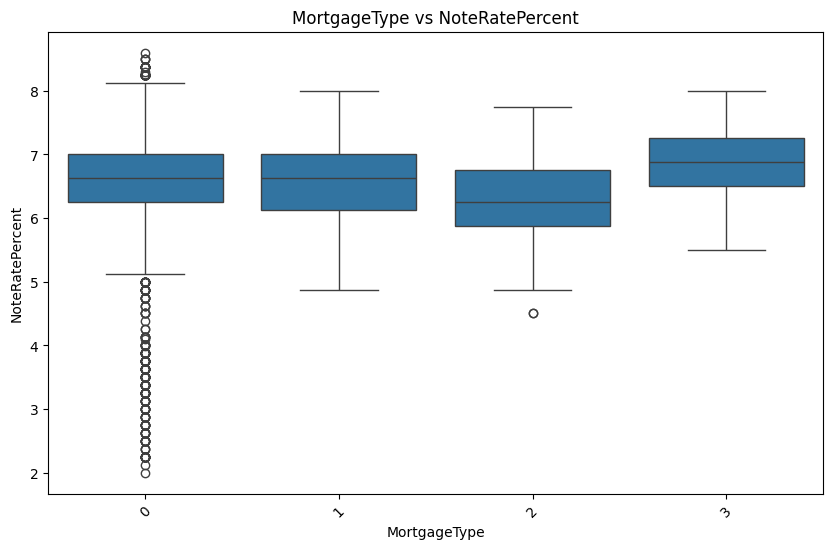

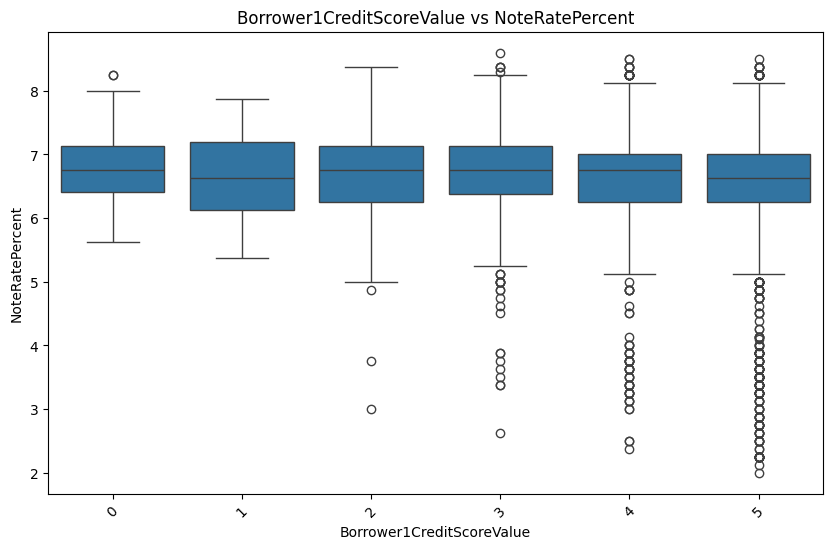

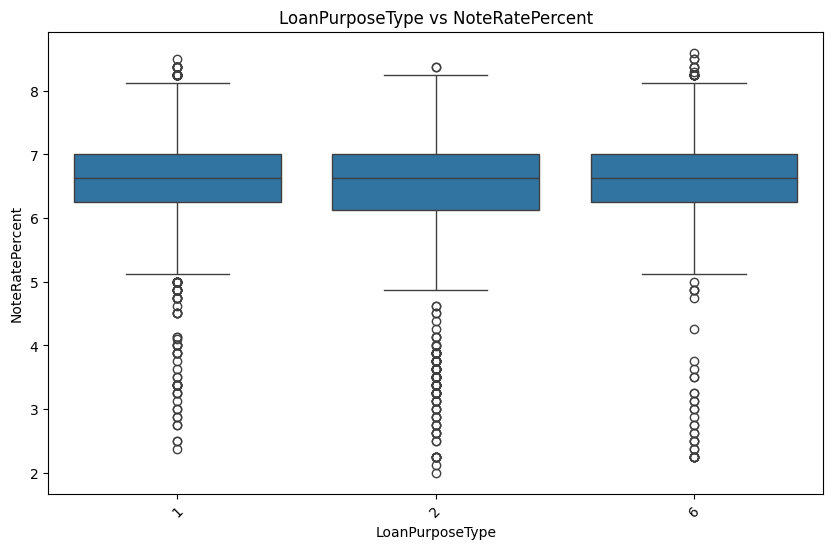

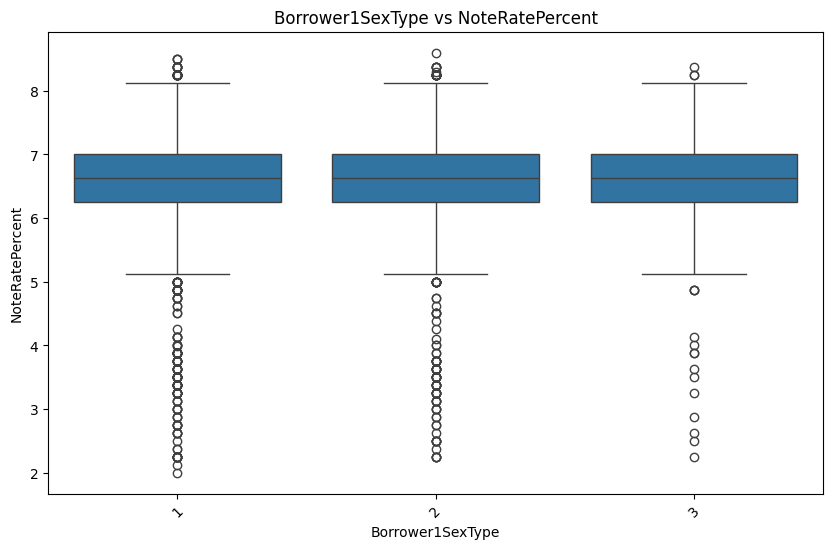

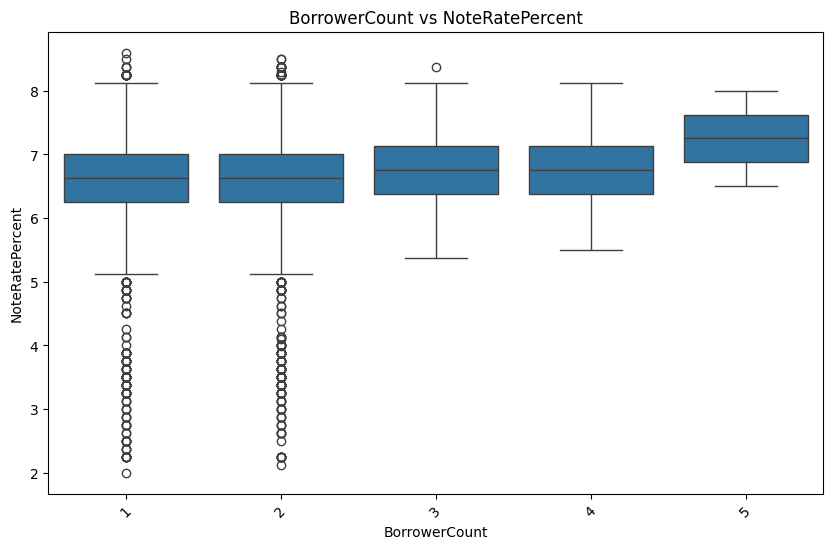

In [66]:
# Columns you want to plot against NoteRatePercent
continuous_cols = [
    'LTVRatioPercent', 
    'TotalMonthlyIncomeAmount', 'Borrower1AgeAtApplicationYears', 
    'HousingExpenseRatioPercent', 
    'TotalDebtExpenseRatioPercent', 
    'LocalAreaMedianIncomeAmount', 
    'CensusTractMinorityRatioPercent', 
    'NoteAmount'
]

categorical_cols = [
    'PropertyType', 'Borrower1EthnicityType',
    'PropertyUnitCount', 
    'Bank', 'MortgageType', 'Borrower1CreditScoreValue',
    'LoanPurposeType', 'Borrower1SexType',
    'BorrowerCount'
]

# Loop through continuous columns and plot scatter plots
for col in continuous_cols:
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x=col, y='NoteRatePercent', data=df)
    plt.title(f'{col} vs NoteRatePercent')
    plt.xlabel(col)
    plt.ylabel('NoteRatePercent')
    plt.show()

# Loop through categorical columns and plot boxplots
for col in categorical_cols:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x=col, y='NoteRatePercent', data=df)
    plt.title(f'{col} vs NoteRatePercent')
    plt.xlabel(col)
    plt.ylabel('NoteRatePercent')
    plt.xticks(rotation=45)  # Rotate for better readability if needed
    plt.show()


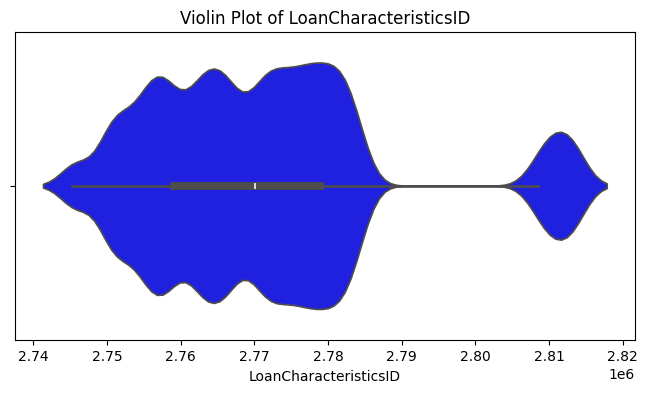

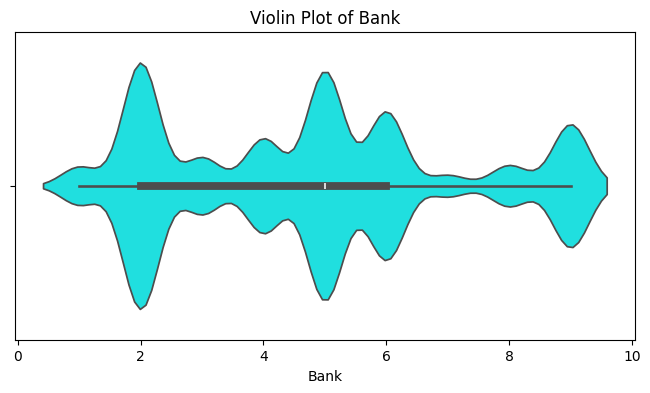

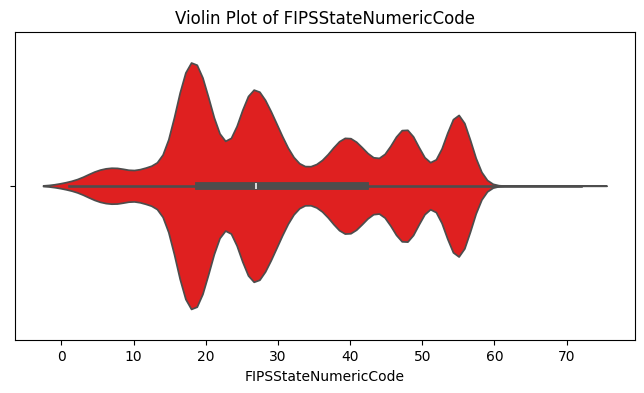

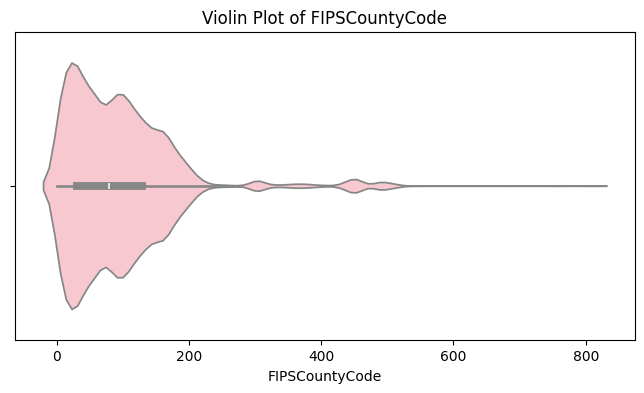

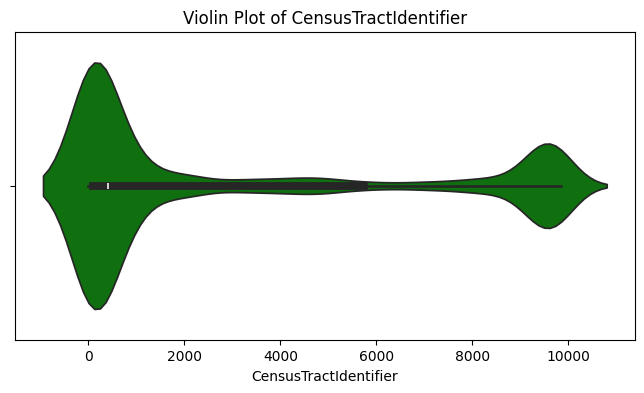

...

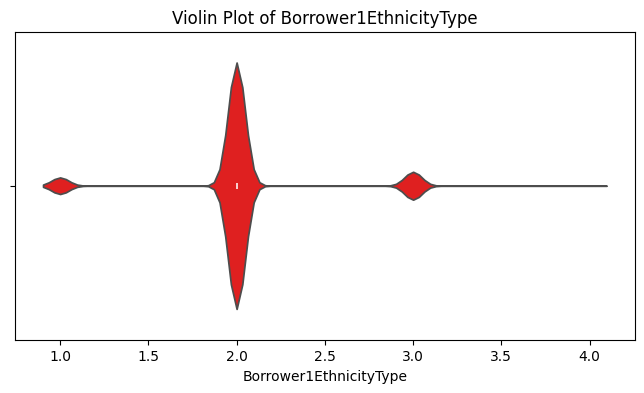

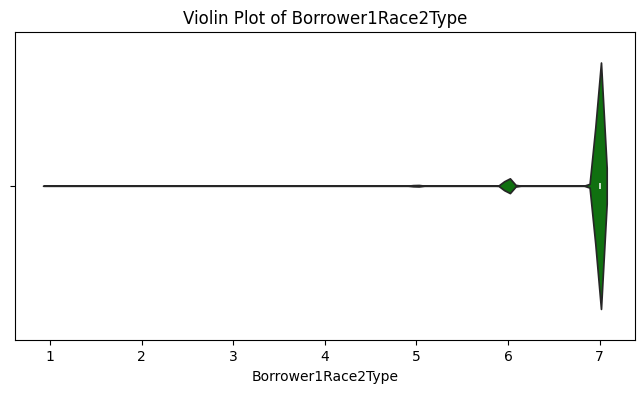

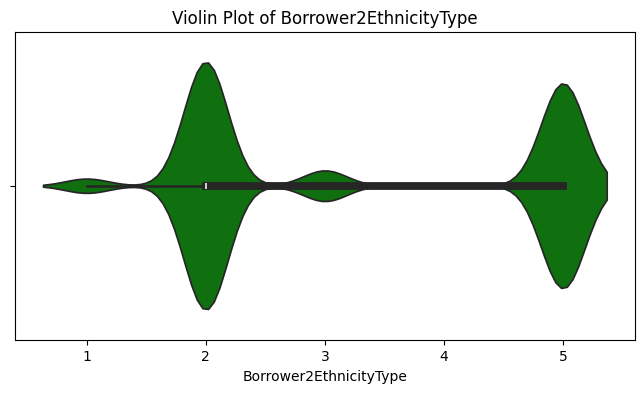

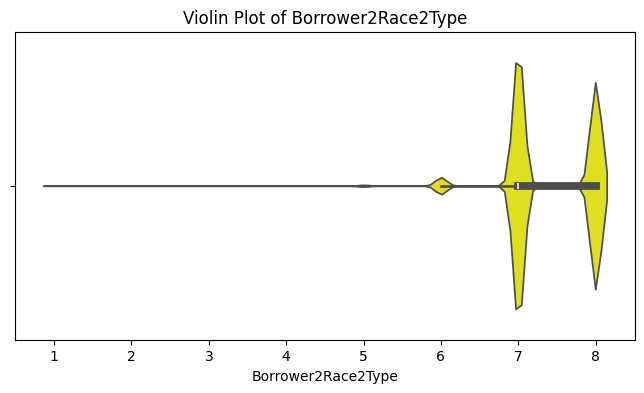

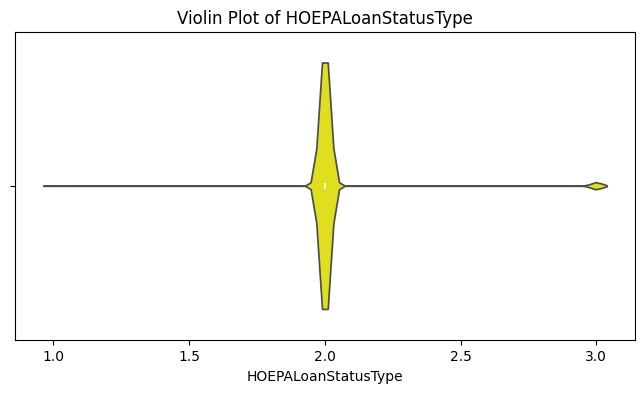

In [133]:

import random

# Define a list of colors for variation
colors = ['blue', 'green', 'red', 'purple', 'orange', 'cyan', 'magenta', 'yellow', 'pink', 'brown']

# Selecting numeric features for visualization
numeric_features = df.select_dtypes(include=[float, int]).columns

# Creating violin plots for each numeric feature with different colors
for feature in numeric_features:
    plt.figure(figsize=(8, 4))
    color_choice = random.choice(colors)  # Randomly select a color for each plot
    sns.violinplot(x=df[feature], color=color_choice)
    plt.title(f'Violin Plot of {feature}')
    plt.show()


In [131]:
"""# Generate pairplot for all numerical features
import seaborn as sns
import matplotlib.pyplot as plt

# Selecting numeric features for pairplot
numeric_features = df.select_dtypes(include=[float, int]).columns

# Creating pairplot (subset of data for efficiency if needed)
sns.pairplot(df[numeric_features], diag_kind='kde', height=2.5)
plt.show()
"""